In [1]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import animation
from IPython.display import HTML, display

This notebook allows us to compare J-PARSE, Damped Least Squares with constant or adaptive damping, Exponential DLS (Carmichael et al., 2017), and regular pseudoinverse (Moore-Penrose right inverse). The nullspace biasing term is not included.

In [ ]:
class JParse(object):

    def __init__(self, extra_demo=False):
      self.extra_demo = extra_demo

    def make_S_matrix(self, S, m, n):
        """
        This function constructs the singular values matrix from a list
        """
        Smat = np.zeros((m, n))
        np.fill_diagonal(Smat, S[:min(m, n)])

        return Smat

    def svd_compose(self,U,S,Vt):
        """
        This function takes SVD: U,S,V and recomposes them for J
        """
        Smat = self.make_S_matrix(S, U.shape[1], Vt.shape[0])
        J_new =np.matrix(U)*Smat*np.matrix(Vt)
        return J_new

    def ConstantDLS(self, J=None, damping=0.1):
        """
        input: Jacobian J (m x n) numpy matrix, damping lambda
        output: J_pinv_damped (n x m) numpy matrix
        """
        J_pinv_damped = np.transpose(J)@np.linalg.inv(J@np.transpose(J) + damping*np.eye(J.shape[1]))

        if self.extra_demo:
          U, S, Vt = np.linalg.svd(J)
          smin = np.min(S)
          return J_pinv_damped, smin/(smin**2 + damping**2)

        return J_pinv_damped

    def EDLS(self, J=None, sigma_plus = 0.3, sigma_minus = 0.1, beta = 0.02):
        """
        input: Jacobian J (m x n) numpy matrix, sigma_plus threshold, sigma_minus threshold, beta base for exponentiation
        output: J_inv_edls (n x m) numpy matrix
        """
        #Perform the SVD decomposition of the jacobian
        U, S, Vt = np.linalg.svd(J)
        Snew = [(1 - beta**((s - sigma_minus)/(sigma_plus - sigma_minus)))/s for s in S]
        Smat = self.make_S_matrix(Snew, U.shape[1],Vt.shape[0])
        J_inv_edls = np.transpose(Vt) @ Smat @ np.transpose(U)

        if self.extra_demo:
          smin = np.min(S)
          return J_inv_edls, (1 - beta**((smin - sigma_minus)/(sigma_plus - sigma_minus)))/smin

        return J_inv_edls

    def JParse(self, J=None, gamma=0.1, exponent = 1, ks = 1):
        """
        input: Jacobian J (m x n) numpy matrix, gamma threshold < 1, exponent >= 1
        output: J_inv_parse (n x m) numpy matrix
        """
        #Perform the SVD decomposition of the jacobian
        U, S, Vt = np.linalg.svd(J)
        sigma_max = np.max(S)
        Snew = [1/s if (s/sigma_max) > gamma else (ks*(s/gamma/sigma_max)**(1/exponent))/gamma/sigma_max for s in S]
        Smat = self.make_S_matrix(Snew, U.shape[1], Vt.shape[0])
        J_inv_parse = np.transpose(Vt) @ Smat @ np.transpose(U)

        if self.extra_demo:
          smin = np.min(S)
          if smin < gamma * sigma_max:
            return J_inv_parse, (ks*(smin/gamma/sigma_max)**(1/exponent))/gamma/sigma_max
          else:
            return J_inv_parse, 1/smin

        return J_inv_parse

    def AdaptiveDLS(self, J=None, gamma=0.1, damping0 = 0.1, w0 = 0.1):
        """
        input: Jacobian J (m x n) numpy matrix
        output: J_pinv_damped (n x m) numpy matrix
        """
        w = np.sqrt(np.linalg.det(J@J.T))
        if w < w0:
          damping = damping0 * (1 - (w/w0))**2
        else:
          damping = 0

        J_pinv_damped = np.transpose(J)@np.linalg.inv(J@np.transpose(J) + damping*np.eye(J.shape[1]))

        if self.extra_demo:
          U, S, Vt = np.linalg.svd(J)
          smin = np.min(S)
          return J_pinv_damped, smin/(smin**2 + damping**2)

        return J_pinv_damped

In [3]:
# 2R kinematics and kinematic control

def forward_kinematics(theta1, theta2, l1=1, l2=1):
    x = l1 * np.cos(theta1) + l2 * np.cos(theta1 + theta2)
    y = l1 * np.sin(theta1) + l2 * np.sin(theta1 + theta2)
    return x, y

def jacobian(theta1, theta2, l1=1, l2=1):
    J11 = -l1 * np.sin(theta1) - l2 * np.sin(theta1 + theta2)
    J12 = -l2 * np.sin(theta1 + theta2)
    J21 =  l1 * np.cos(theta1) + l2 * np.cos(theta1 + theta2)
    J22 =  l2 * np.cos(theta1 + theta2)
    J = np.array([[J11, J12],
                  [J21, J22]])
    return J

def control_law(x_current, y_current, x_des, y_des, theta1, theta2, jparse_cls_obj=None, method="dls", damping=0.1, w0 = 0.1, sigma_plus=0.3, sigma_minus=0.1, beta=0.02, gamma=0.1, exponent=1, ks=1, k_pos=0.1, l1=1, l2=1):
    gains = np.array([k_pos]*2, dtype=float)
    # now put them into a matrix:
    K = np.diag(gains) # proportional gain; adjust as needed
    error = np.array([x_des - x_current, y_des - y_current])
    if np.linalg.norm(error) > 1:
      error = error/np.linalg.norm(error)
    v_des = K @ error

    J = jacobian(theta1, theta2, l1=l1, l2=l2)

    extra_val = 0.0

    if method == "dls":
        result = jparse_cls_obj.ConstantDLS(J, damping=damping)
    elif method == "adls":
        result = jparse_cls_obj.AdaptiveDLS(J, damping0=damping, w0=w0)
    elif method == "Jparse":
        result = jparse_cls_obj.JParse(J, gamma=gamma, ks=1, exponent=1)
    elif method == "sqrtJP":
        result = jparse_cls_obj.JParse(J, gamma=gamma, ks=1, exponent=2)
    elif method == "genJP":
        result = jparse_cls_obj.JParse(J, gamma=gamma, ks=1, exponent=exponent)
    elif method == "edls":
        result = jparse_cls_obj.EDLS(J, sigma_minus=sigma_minus, sigma_plus=sigma_plus, beta=beta)
    elif method == "pinv":
        result = jparse_cls_obj.ConstantDLS(J, damping=0)
    else:
        print("Method undefined")
        return np.zeros_like(v_des)

    if jparse_cls_obj.extra_demo:
        J_rinv, extra_val = result
    else:
        J_rinv = result
        extra_val = 1

    dq = J_rinv @ v_des

    return dq, extra_val

In [4]:
colordict = {
      "Jparse": "b", #"#4575b4",
      "Jparse_high": "b", #"#4575b4",
      "Jparse_low": "b", #"#4575b4",
      "dls": "#fc8d59",
      "adls": "r", #"#d73027",
      "edls": "#91bfdb",
      "dls_more": "#fc8d59",
      "dls_less": "#fc8d59",
      "adls_more": "r", #"#d73027",
      "adls_less": "r", #"#d73027",
      "sqrtJP": "m",
      "pinv": "c",
  }

In [ ]:
def run_simulation(
    dt=0.05,
    T_total=80.0,
    l1=1.0,
    l2=1.0,
    gamma=0.05,
    gamma_more=0.1,
    gamma_less=0.02,
    damping=0.1,
    damping_more = 0.1,
    damping_less = 0.1,
    w0=1.0,
    w0_more = 0.1,
    w0_less = 0.1,
    sigma_plus=0.3,
    sigma_minus=0.1,
    beta=0.02,
    ks=1.0,
    JParse=None,
    forward_kinematics=None,
    control_law=None,
    methods =  ["Jparse", "Jparse_high", "Jparse_low", "dls", "dls_more", "dls_less" "adls", "adls_more", "adls_less", "edls", "sqrtJP", "pinv"],
    extra_demo=True,
    colors = colordict
) :
    """
    Run a multi-method control simulation for a 2-link planar arm.

    Parameters
    ----------
    dt : float
        Simulation time step (s)
    T_total : float
        Total simulation duration (s)
    l1, l2 : float
        Link lengths (m)
    gamma, damping, w0, sigma_minus, exponent, ks : float
        Control law parameters
    JParse : callable
        Constructor for JParse class (must be provided)
    forward_kinematics : callable
        Function taking (theta1, theta2) and returning (x, y)
    control_law : callable
        Function implementing the control law; must accept keyword args described below

    Returns
    -------
    results : dict
        Dictionary containing simulation histories for each control method.
    """

    assert JParse is not None, "Please pass your JParse class"
    assert forward_kinematics is not None, "Please pass your forward_kinematics function"
    assert control_law is not None, "Please pass your control_law function"

    # Setup
    time = np.arange(0, T_total, dt)
    time_steps = len(time)

    # Target (constant)
    x_des = 1.1 * np.sqrt(2) * l2
    y_des = 1.1 * np.sqrt(2) * l2

    # Allocate histories
    hist = {
        m: {
            "theta1": np.zeros(time_steps),
            "theta2": np.zeros(time_steps),
            "x": np.zeros(time_steps),
            "y": np.zeros(time_steps),
            "s": np.zeros(time_steps),
        }
        for m in methods
    }

    # Initial joint angles
    theta_init = [-np.pi / 4, np.pi / 4]
    for m in methods:
        hist[m]["theta1"][0], hist[m]["theta2"][0] = theta_init

    # Instantiate JParse class once
    J_parse_cls = JParse(extra_demo=extra_demo)

    # --- Main loop ---
    for i in range(1, time_steps):
        for m in methods:
            theta1 = hist[m]["theta1"][i - 1]
            theta2 = hist[m]["theta2"][i - 1]

            # Forward kinematics
            x, y = forward_kinematics(theta1, theta2, l1, l2)
            hist[m]["x"][i], hist[m]["y"][i] = x, y

            # Build control arguments
            ctrl_args = {"jparse_cls_obj": J_parse_cls, "method": m}
            if m == "Jparse":
                ctrl_args.update(gamma=gamma, ks=ks)
            elif m == "dls":
                ctrl_args.update(damping=damping)
            elif m == "adls":
                ctrl_args.update(damping=damping, w0=w0)
            elif m == "edls":
                ctrl_args.update(sigma_plus=sigma_plus, sigma_minus=sigma_minus, beta=beta)
            elif m == "sqrtJP":
                ctrl_args.update(gamma=gamma) # ks not used here
            elif m == "pinv":
                ctrl_args.update(damping=0)
            elif m == "dls_more":
                ctrl_args.update(damping=damping_more)
                ctrl_args["method"] = "dls"
            elif m == "dls_less":
                ctrl_args.update(damping=damping_less)
                ctrl_args["method"] = "dls"
            elif m == "adls_more":
                ctrl_args.update(damping=damping, w0=w0_more)
                ctrl_args["method"] = "adls"
            elif m == "adls_less":
                ctrl_args.update(damping=damping, w0=w0_less)
                ctrl_args["method"] = "adls"
            elif m == "Jparse_high":
                ctrl_args.update(gamma=gamma_more, ks=ks)
                ctrl_args["method"] = "Jparse"
            elif m == "Jparse_low":
                ctrl_args.update(gamma=gamma_less, ks=ks)
                ctrl_args["method"] = "Jparse"



            # Compute dq and integrate
            dq, s = control_law(x, y, x_des, y_des, theta1, theta2, **ctrl_args)
            hist[m]["theta1"][i] = theta1 + dq[0] * dt
            hist[m]["theta2"][i] = theta2 + dq[1] * dt
            hist[m]["s"][i] = s

    results = {
        "time": time,
        "methods": methods,
        "hist": hist,
        "params": dict(
            dt=dt,
            gamma=gamma,
            damping=damping,
            damping_more=damping_more,
            damping_less=damping_less,
            w0=w0,
            w0_more=w0_more,
            w0_less=w0_less,
            sigma_minus=sigma_minus,
            sigma_plus=sigma_plus,
            beta=beta,
            ks=ks,
            l1=l1,
            l2=l2,
            x_des = x_des,
            y_des = y_des,
        ),
    }

    return results

def animate_results(results, colors=colordict):

  time = results["time"]
  hist = results["hist"]
  methods = results["methods"]
  l1 = results["params"]["l1"]
  l2 = results["params"]["l2"]
  x_des = results["params"]["x_des"]
  y_des = results["params"]["y_des"]

  fig, ax = plt.subplots()
  ax.set_xlim(-2, 2)
  ax.set_ylim(-2, 2)
  ax.set_aspect('equal')
  ax.set_title("2-Link Robot Arm Going to Target")

  # Create lines dynamically
  lines = {}
  for m, c in colors.items():
      lines[m] = {
          "link": ax.plot([], [], f'o-', color=c, lw=3)[0],
          "target": ax.plot([], [], f'x', color=c, markersize=10)[0],
          "path": ax.plot([], [], color=c, lw=1)[0],
          "ee_trace": ax.plot([], [], '-', alpha=0.7, linewidth=1)[0]
      }

  def init():
      for m in methods:
          lines[m]["link"].set_data([], [])
          lines[m]["target"].set_data([], [])
          lines[m]["path"].set_data([], [])
      return sum([list(d.values()) for d in lines.values()], [])

  def animate(i):
      for m in methods:
        th1, th2 = hist[m]["theta1"][i], hist[m]["theta2"][i]
        j2 = np.array([l1*np.cos(th1), l1*np.sin(th1)])
        ee = j2 + np.array([l2*np.cos(th1+th2), l2*np.sin(th1+th2)])
        lines[m]["link"].set_data([0, j2[0], ee[0]], [0, j2[1], ee[1]])
        lines[m]["target"].set_data([x_des], [y_des])
        lines[m]["path"].set_data(hist[m]["x"][:i], hist[m]["y"][:i])

        # Add end-effector trace
        ee_x = hist[m]["x"][:i+1]  # or calculate from theta1, theta2 history
        ee_y = hist[m]["y"][:i+1]
        lines[m]["ee_trace"].set_data(ee_x, ee_y)

      return sum([list(d.values()) for d in lines.values()], [])

  ani = animation.FuncAnimation(fig, animate, frames=len(time),
                                init_func=init, interval=50, blit=True)

  return ani


def plot_results(results, colors=colordict):
    """Plot joint angles and end-effector positions for all methods."""
    time = results["time"]
    hist = results["hist"]
    methods = results["methods"]
    l1 = results["params"]["l1"]
    l2 = results["params"]["l2"]


    linestyles = {
        "Jparse": 'dashed',
        "Jparse_high": "dotted",
        "Jparse_low": "solid",
        "dls":  'dashed',
        "adls":  'dashed',
        "edls":  'solid',
        "dls_more":  'solid',
        "dls_less":  'dotted',
        "adls_more":  'solid',
        "adls_less":  'dotted',
        "sqrtJP":  'solid',
        "pinv":  'solid',
    }

    labels = {
        "Jparse": 'JParse',
        "Jparse_high": r'JParse (higher $\gamma$)',
        "Jparse_low": r'JParse (lower $\gamma$)',
        "dls":  'DLS',
        "adls":  'ADLS',
        "edls":  'EDLS',
        "dls_more":  r'DLS (higher $\lambda$)',
        "dls_less":  r'DLS (lower $\lambda$)',
        "adls_more":  r'ADLS (higher $w_0$)',
        "adls_less":  r'ADLS (lower $w_0$)',
        "sqrtJP":  'JParse (sqrt variant)',
        "pinv":  'Pseudoinverse',
    }

    # Plot joint angles
    fig, axs = plt.subplots(2, 1, figsize=(10, 6), sharex=True)
    for m in methods:
        axs[0].plot(time, hist[m]["theta1"], label=labels[m], color=colors[m], linestyle=linestyles[m], linewidth=1)
        axs[1].plot(time, hist[m]["theta2"], label=labels[m], color=colors[m], linestyle=linestyles[m], linewidth=1)

    # axs[0].set_ylabel(r"$\theta_1$ [rad]")
    # axs[1].set_ylabel(r"$\theta_2$ [rad]")

    axs[0].set_ylabel(r"$q_1$ [rad]")
    axs[1].set_ylabel(r"$q_2$ [rad]")
    axs[1].set_xlabel("Time [s]")
    axs[0].legend()
    axs[0].grid(True)
    axs[1].grid(True)
    # fig.suptitle("Joint Angles vs Time")

    # Plot end-effector position
    fig2, axs2 = plt.subplots(2, 1, figsize=(10, 6), sharex=True)
    for m in methods:
        axs2[0].plot(time, hist[m]["x"], label=labels[m], color=colors[m], linestyle=linestyles[m], linewidth=1)
        axs2[1].plot(time, hist[m]["y"], label=labels[m], color=colors[m], linestyle=linestyles[m], linewidth=1)

    axs2[0].set_ylabel("x [m]")
    axs2[1].set_ylabel("y [m]")
    axs2[1].set_xlabel("Time [s]")
    axs2[0].legend()
    axs2[0].grid(True)
    axs2[1].grid(True)
    fig2.suptitle("End-Effector Position vs Time")

    plt.tight_layout()
    plt.show()

    fig3, axs3 = plt.subplots(figsize=(10, 4))
    for m in methods:
        axs3.plot(time[1:], hist[m]["s"][1:], label=labels[m], color=colors[m], linestyle=linestyles[m], linewidth=1)
    axs3.set_xlabel("Time [s]")
    axs3.set_ylabel("$S^\prime(\sigma_{min})$")
    axs3.legend()
    axs3.grid(True)
    # fig3.suptitle("Inverse singular value vs Time")
    axs3.set_ylim(0, 70)

    plt.tight_layout()
    plt.show()

    fig4, axs4 = plt.subplots(figsize=(10, 10))
    for m in methods:
      axs4.plot(time[1:], hist[m]["s"][1:], label=labels[m], color=colors[m], linestyle=linestyles[m], linewidth=0.5)
    axs4.set_xlabel("Time [s]")
    axs4.set_ylabel("s")
    axs4.legend()
    axs4.grid(True)
    fig4.suptitle("Inverse singular value vs Time")
    axs4.set_ylim(0, 15)

    plt.tight_layout()
    plt.show()

    # Plot joint speeds
    fig5, axs5 = plt.subplots(2, 1, figsize=(10, 10), sharex=True)

    dt = time[1] - time[0]  # Get time step

    start_time = int(len(time)/4)
    end_time = int(len(time)/3)

    for m in methods:
        dtheta1_dt = np.gradient(hist[m]["theta1"], dt)
        dtheta2_dt = np.gradient(hist[m]["theta2"], dt)

        axs5[0].plot(time[start_time:end_time], dtheta1_dt[start_time:end_time], label=labels[m], color=colors[m],
                    linestyle=linestyles[m], linewidth=1)
        axs5[1].plot(time[start_time:end_time], dtheta2_dt[start_time:end_time], label=labels[m], color=colors[m],
                    linestyle=linestyles[m], linewidth=1)

    # axs5[0].set_ylabel(r"$\dot{\theta}_1$ [rad/s]")
    # axs5[1].set_ylabel(r"$\dot{\theta}_2$ [rad/s]")
    axs5[0].set_ylabel(r"$q_1$ [rad/s]")
    axs5[1].set_ylabel(r"$q_2$ [rad/s]")
    axs5[1].set_xlabel("Time [s]")
    axs5[0].legend()
    axs5[0].grid(True)
    axs5[1].grid(True)
    # fig5.suptitle("Joint Velocities vs Time")

    plt.tight_layout()
    plt.show()

    # Plot end-effector trajectories in the x-y plane
    fig6, axs6 = plt.subplots(figsize=(8, 8))

    # Target position
    x_des = 1.1 * np.sqrt(2) * l2
    y_des = 1.1 * np.sqrt(2) * l2

    # Plot target
    axs6.plot(x_des, y_des, marker="*", color="orange", markersize=15,
            label="Target", zorder=10)

    # Plot trajectories for each method
    for m in methods:
        axs6.plot(hist[m]["x"], hist[m]["y"], label=labels[m], color=colors[m],
                linestyle=linestyles[m], linewidth=2)

        # Optional: mark start and end points
        axs6.plot(hist[m]["x"][0], hist[m]["y"][0], 'o', color=colors[m],
                markersize=8, markeredgecolor='black', markeredgewidth=1)
        axs6.plot(hist[m]["x"][-1], hist[m]["y"][-1], 's', color=colors[m],
                markersize=8, markeredgecolor='black', markeredgewidth=1)

    axs6.set_xlabel("x [m]")
    axs6.set_ylabel("y [m]")
    axs6.set_aspect("equal", adjustable="box")
    axs6.legend()
    axs6.grid(True, alpha=0.3)
    axs6.set_title("End-Effector Trajectories in Task Space")

    plt.tight_layout()
    plt.show()


<>:293: SyntaxWarning: invalid escape sequence '\p'
<>:293: SyntaxWarning: invalid escape sequence '\p'
/tmp/ipython-input-4169390272.py:293: SyntaxWarning: invalid escape sequence '\p'
  axs3.set_ylabel("$S^\prime(\sigma_{min})$")


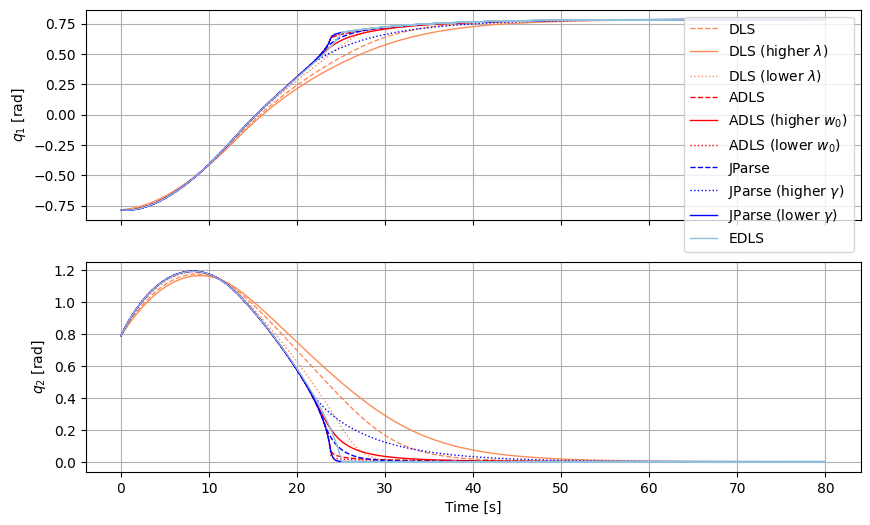

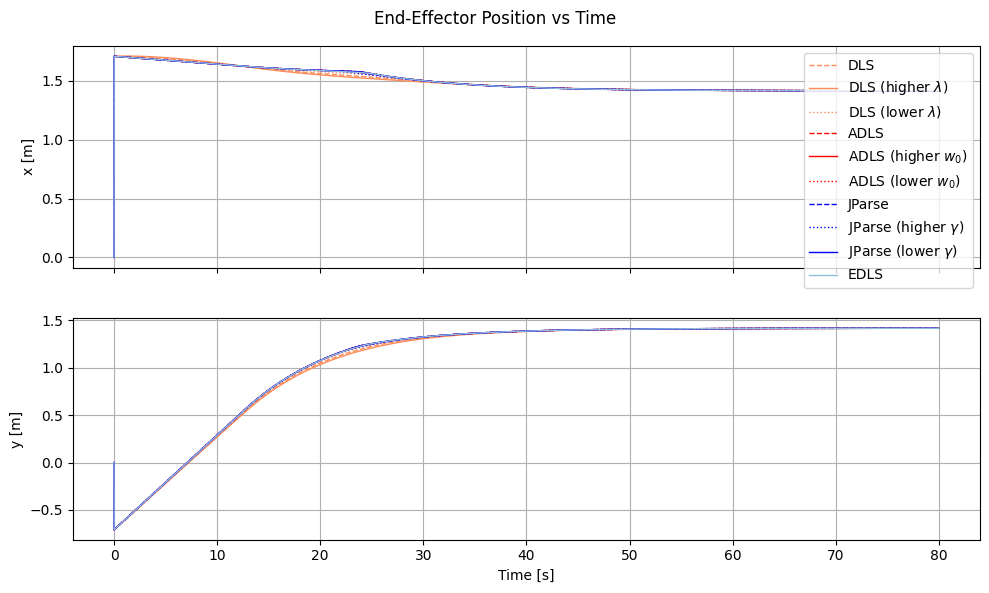

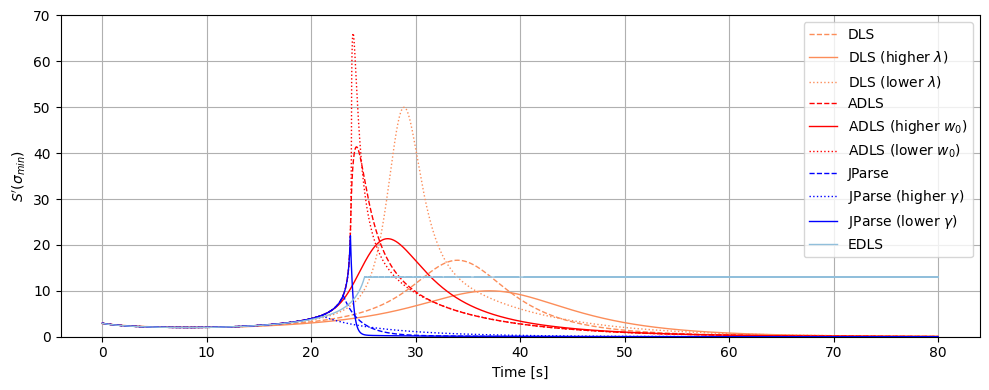

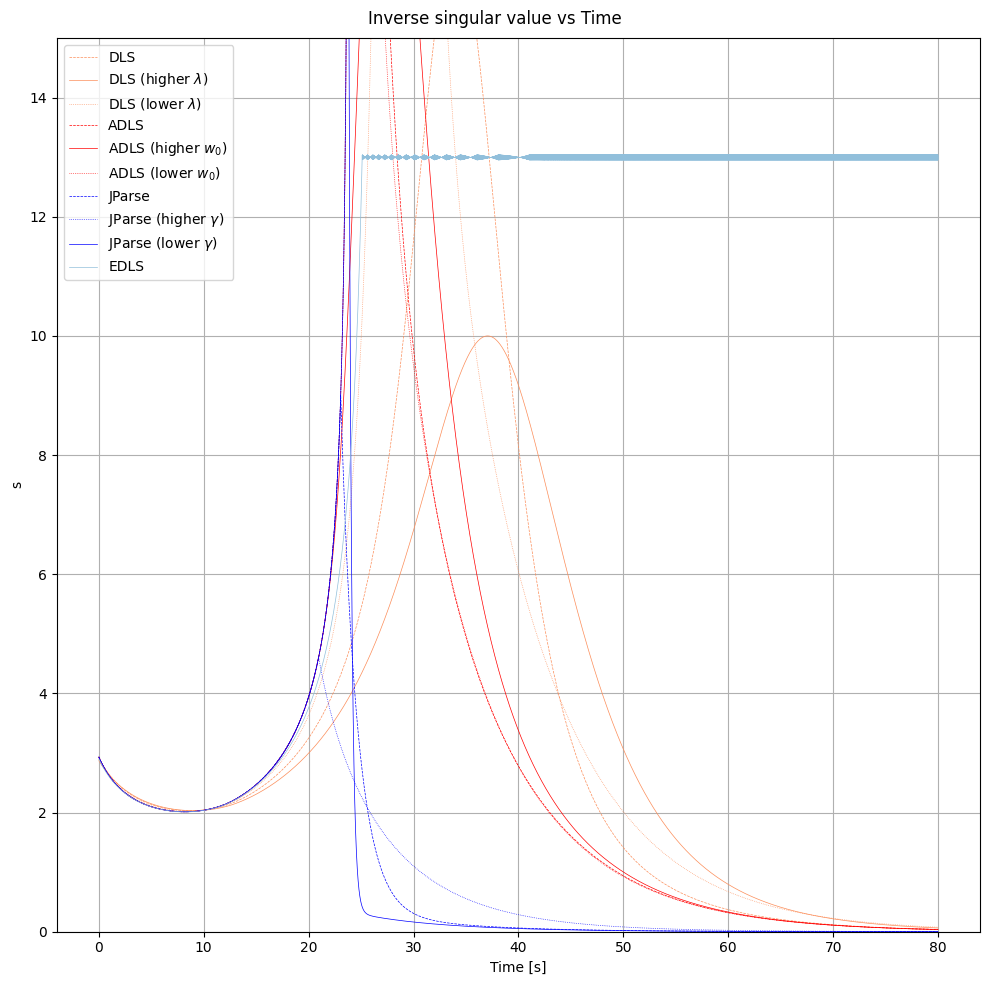

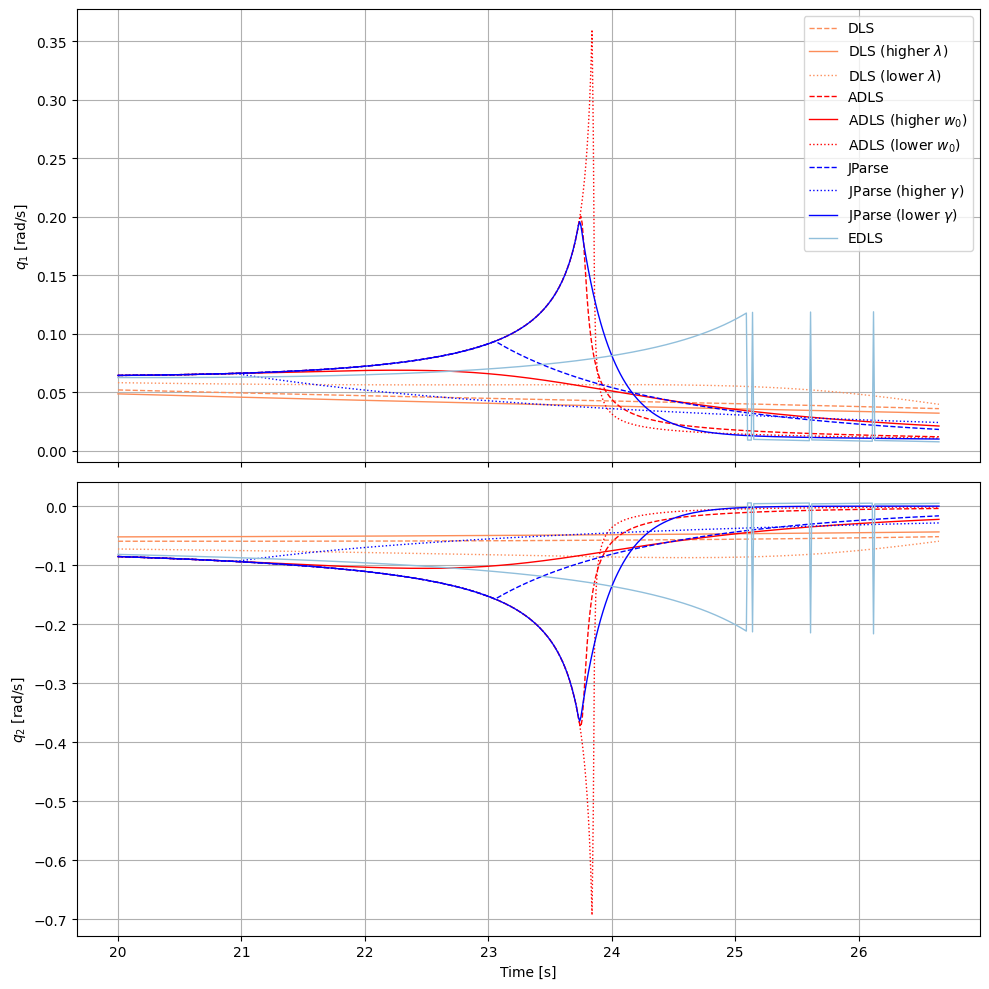

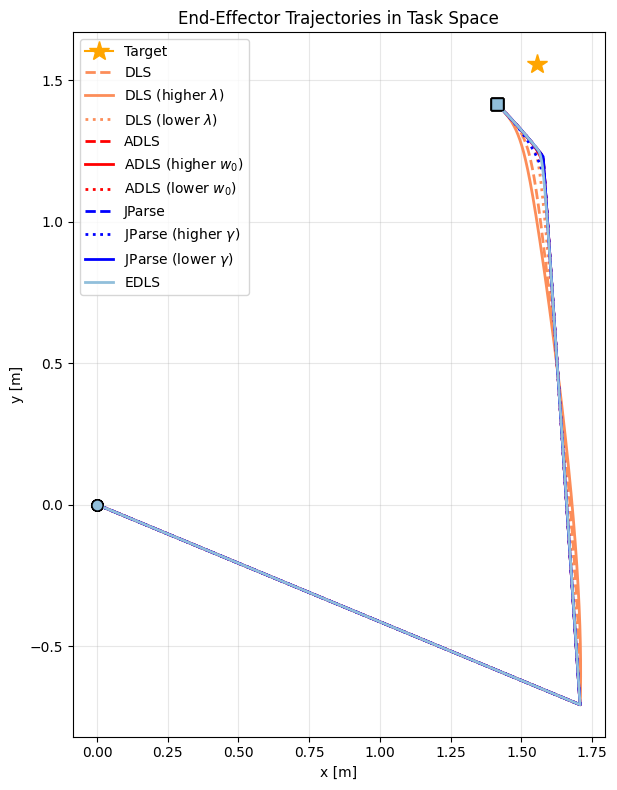

In [ ]:
results = run_simulation(
    dt=0.01,
    gamma=0.05,
    gamma_more=0.1,
    gamma_less=0.02,
    damping=0.03,
    damping_more = 0.05,
    damping_less = 0.01,
    w0=0.1,
    w0_more = 0.5,
    w0_less = 0.05,
    sigma_minus=0.0,
    JParse=JParse,
    forward_kinematics=forward_kinematics,
    control_law=control_law,
    methods =  ["dls", "dls_more", "dls_less", "adls", "adls_more", "adls_less", "Jparse", "Jparse_high", "Jparse_low", "edls"],
    extra_demo=True,
    )

plot_results(results)


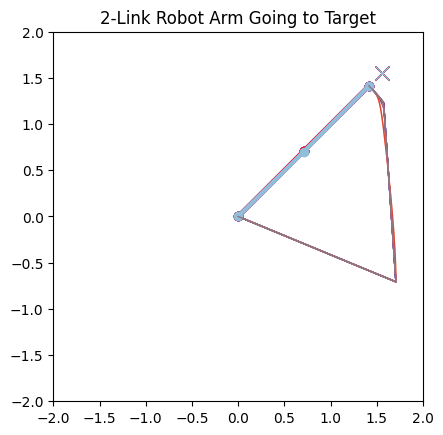

In [ ]:
results_coarse = run_simulation(
    dt=0.05,
    gamma=0.05,
    gamma_more=0.1,
    gamma_less=0.02,
    damping=0.03,
    damping_more = 0.05,
    damping_less = 0.01,
    w0=0.1,
    w0_more = 0.5,
    w0_less = 0.05,
    sigma_minus=0.0,
    JParse=JParse,
    forward_kinematics=forward_kinematics,
    control_law=control_law,
    methods =  ["Jparse", "Jparse_high", "Jparse_low", "dls", "adls", "edls"],
    extra_demo=True,
    )


ani = animate_results(results_coarse)
HTML(ani.to_jshtml())
